In [88]:
import matplotlib.pyplot as plt
import os
import torch
import numpy as np
import torch
import torch.nn as nn
from collections import deque

import torch.nn.functional as F

import argparse
import logging
from torchinfo import summary
import argparse
import wandb
import psutil


import torch.multiprocessing as mp
from torch.nn.parallel import DistributedDataParallel as DDP
from torch.distributed import init_process_group, destroy_process_group


from joblib import Parallel, delayed
from pesq import pesq
from utils import LearnableSigmoid

In [66]:

class replay_buffer:
    def __init__(self, max_size, gpu_id=None):
        self.buffer = deque(maxlen=max_size)
        self.gpu_id = gpu_id

    def push(self, state, action, reward, next_state, t):
        experience = {'curr':state,
                      'action':action,
                      'reward':reward,
                      'next':next_state, 
                      't':t}
        self.buffer.append(experience)

    def sample(self):
        idx = np.random.choice(len(self.buffer), 1)[0]
        if self.gpu_id is None:
            retval = {'curr':{k:torch.FloatTensor(v) for k, v in self.buffer[idx]['curr'].items()},
                      'next':{k:torch.FloatTensor(v) for k, v in self.buffer[idx]['next'].items()},
                      'action':(torch.FloatTensor(self.buffer[idx]['action'][0]),
                                torch.FloatTensor(self.buffer[idx]['action'][1])),
                      'reward':torch.FloatTensor(self.buffer[idx]['reward']),
                      't':self.buffer[idx]['t']
                     }
        else:
            retval = {'curr':{k:torch.FloatTensor(v).to(self.gpu_id) for k, v in self.buffer[idx]['curr'].items()},
                      'next':{k:torch.FloatTensor(v).to(self.gpu_id) for k, v in self.buffer[idx]['next'].items()},
                      'action':(torch.FloatTensor(self.buffer[idx]['action'][0]).to(self.gpu_id),
                                torch.FloatTensor(self.buffer[idx]['action'][1]).to(self.gpu_id)),
                      'reward':torch.FloatTensor(self.buffer[idx]['reward']).to(self.gpu_id),
                      't':self.buffer[idx]['t']
                     }
        return retval

    def __len__(self):
        return len(self.buffer)


In [28]:
def pesq_loss(clean, noisy, sr=16000):
    try:
        pesq_score = pesq(sr, clean, noisy, "wb")
    except:
        # error can happen due to silent period
        pesq_score = -1
    return pesq_score


def batch_pesq(clean, noisy):
    pesq_score = []
    for c,n in zip(clean, noisy):
        pesq = pesq_loss(c, n)
        pesq_score.append(pesq)
    #Mask invalid pesq scores
    score_mask = np.array([1 if pqs > -1 else 0 for pqs in pesq_score])
    pesq_score = np.array(pesq_score)
    #pesq_score = (pesq_score - 1) / 3.5
    #print(pesq, score_mask)
    return torch.FloatTensor(score_mask), torch.FloatTensor(pesq_score)

def power_compress(x):
    real = x[..., 0]
    imag = x[..., 1]
    spec = torch.complex(real, imag)
    mag = torch.abs(spec)
    phase = torch.angle(spec)
    mag = mag**0.3
    real_compress = mag * torch.cos(phase)
    imag_compress = mag * torch.sin(phase)
    return torch.stack([real_compress, imag_compress], 1)


def power_uncompress(real, imag):
    spec = torch.complex(real, imag)
    mag = torch.abs(spec)
    phase = torch.angle(spec)
    mag = mag ** (1.0 / 0.3)
    real_compress = mag * torch.cos(phase)
    imag_compress = mag * torch.sin(phase)
    return torch.stack([real_compress, imag_compress], -1)


class LearnableSigmoid(nn.Module):
    def __init__(self, in_features, beta=1):
        super().__init__()
        self.beta = beta
        self.slope = nn.Parameter(torch.ones(in_features))
        self.slope.requiresGrad = True

    def forward(self, x):
        return self.beta * torch.sigmoid(self.slope * x)

In [29]:
import torch
from torch import nn, einsum
import torch.nn.functional as F

from einops import rearrange
from einops.layers.torch import Rearrange

# source: https://github.com/lucidrains/conformer/blob/master/conformer/conformer.py
# helper functions


def exists(val):
    return val is not None


def default(val, d):
    return val if exists(val) else d


def calc_same_padding(kernel_size):
    pad = kernel_size // 2
    return (pad, pad - (kernel_size + 1) % 2)


class Swish(nn.Module):
    def forward(self, x):
        return x * x.sigmoid()


class GLU(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.dim = dim

    def forward(self, x):
        out, gate = x.chunk(2, dim=self.dim)
        return out * gate.sigmoid()


class DepthWiseConv1d(nn.Module):
    def __init__(self, chan_in, chan_out, kernel_size, padding):
        super().__init__()
        self.padding = padding
        self.conv = nn.Conv1d(chan_in, chan_out, kernel_size, groups=chan_in)

    def forward(self, x):
        x = F.pad(x, self.padding)
        return self.conv(x)


# attention, feedforward, and conv module


class Scale(nn.Module):
    def __init__(self, scale, fn):
        super().__init__()
        self.fn = fn
        self.scale = scale

    def forward(self, x, **kwargs):
        return self.fn(x, **kwargs) * self.scale


class PreNorm(nn.Module):
    def __init__(self, dim, fn):
        super().__init__()
        self.fn = fn
        self.norm = nn.LayerNorm(dim)

    def forward(self, x, **kwargs):
        x = self.norm(x)
        return self.fn(x, **kwargs)


class Attention(nn.Module):
    def __init__(self, dim, heads=8, dim_head=64, dropout=0.0, max_pos_emb=512):
        super().__init__()
        inner_dim = dim_head * heads
        self.heads = heads
        self.scale = dim_head**-0.5
        self.to_q = nn.Linear(dim, inner_dim, bias=False)
        self.to_kv = nn.Linear(dim, inner_dim * 2, bias=False)
        self.to_out = nn.Linear(inner_dim, dim)

        self.max_pos_emb = max_pos_emb
        self.rel_pos_emb = nn.Embedding(2 * max_pos_emb + 1, dim_head)

        self.dropout = nn.Dropout(dropout)

    def forward(self, x, context=None, mask=None, context_mask=None):
        n, device, h, max_pos_emb, has_context = (
            x.shape[-2],
            x.device,
            self.heads,
            self.max_pos_emb,
            exists(context),
        )
        context = default(context, x)

        q, k, v = (self.to_q(x), *self.to_kv(context).chunk(2, dim=-1))
        q, k, v = map(lambda t: rearrange(t, "b n (h d) -> b h n d", h=h), (q, k, v))

        dots = einsum("b h i d, b h j d -> b h i j", q, k) * self.scale

        # shaw's relative positional embedding
        seq = torch.arange(n, device=device)
        dist = rearrange(seq, "i -> i ()") - rearrange(seq, "j -> () j")
        dist = dist.clamp(-max_pos_emb, max_pos_emb) + max_pos_emb
        rel_pos_emb = self.rel_pos_emb(dist).to(q)
        pos_attn = einsum("b h n d, n r d -> b h n r", q, rel_pos_emb) * self.scale
        dots = dots + pos_attn

        if exists(mask) or exists(context_mask):
            mask = default(mask, lambda: torch.ones(*x.shape[:2], device=device))
            context_mask = (
                default(context_mask, mask)
                if not has_context
                else default(
                    context_mask, lambda: torch.ones(*context.shape[:2], device=device)
                )
            )
            mask_value = -torch.finfo(dots.dtype).max
            mask = rearrange(mask, "b i -> b () i ()") * rearrange(
                context_mask, "b j -> b () () j"
            )
            dots.masked_fill_(~mask, mask_value)

        attn = dots.softmax(dim=-1)

        out = einsum("b h i j, b h j d -> b h i d", attn, v)
        out = rearrange(out, "b h n d -> b n (h d)")
        out = self.to_out(out)
        return self.dropout(out)


class FeedForward(nn.Module):
    def __init__(self, dim, mult=4, dropout=0.0):
        super().__init__()
        self.net = nn.Sequential(
            nn.Linear(dim, dim * mult),
            Swish(),
            nn.Dropout(dropout),
            nn.Linear(dim * mult, dim),
            nn.Dropout(dropout),
        )

    def forward(self, x):
        return self.net(x)


class ConformerConvModule(nn.Module):
    def __init__(
        self, dim, causal=False, expansion_factor=2, kernel_size=31, dropout=0.0
    ):
        super().__init__()

        inner_dim = dim * expansion_factor
        padding = calc_same_padding(kernel_size) if not causal else (kernel_size - 1, 0)

        self.net = nn.Sequential(
            nn.LayerNorm(dim),
            Rearrange("b n c -> b c n"),
            nn.Conv1d(dim, inner_dim * 2, 1),
            GLU(dim=1),
            DepthWiseConv1d(
                inner_dim, inner_dim, kernel_size=kernel_size, padding=padding
            ),
            nn.BatchNorm1d(inner_dim) if not causal else nn.Identity(),
            Swish(),
            nn.Conv1d(inner_dim, dim, 1),
            Rearrange("b c n -> b n c"),
            nn.Dropout(dropout),
        )

    def forward(self, x):
        return self.net(x)


# Conformer Block


class ConformerBlock(nn.Module):
    def __init__(
        self,
        *,
        dim,
        dim_head=64,
        heads=8,
        ff_mult=4,
        conv_expansion_factor=2,
        conv_kernel_size=31,
        attn_dropout=0.0,
        ff_dropout=0.0,
        conv_dropout=0.0
    ):
        super().__init__()
        self.ff1 = FeedForward(dim=dim, mult=ff_mult, dropout=ff_dropout)
        self.attn = Attention(
            dim=dim, dim_head=dim_head, heads=heads, dropout=attn_dropout
        )
        self.conv = ConformerConvModule(
            dim=dim,
            causal=False,
            expansion_factor=conv_expansion_factor,
            kernel_size=conv_kernel_size,
            dropout=conv_dropout,
        )
        self.ff2 = FeedForward(dim=dim, mult=ff_mult, dropout=ff_dropout)

        self.attn = PreNorm(dim, self.attn)
        self.ff1 = Scale(0.5, PreNorm(dim, self.ff1))
        self.ff2 = Scale(0.5, PreNorm(dim, self.ff2))

        self.post_norm = nn.LayerNorm(dim)

    def forward(self, x, mask=None):
        x = self.ff1(x) + x
        x = self.attn(x, mask=mask) + x
        x = self.conv(x) + x
        x = self.ff2(x) + x
        x = self.post_norm(x)
        return x

In [132]:

class DilatedDenseNet(nn.Module):
    def __init__(self, depth=4, in_channels=64):
        super(DilatedDenseNet, self).__init__()
        self.depth = depth
        self.in_channels = in_channels
        self.pad = nn.ConstantPad2d((1, 1, 1, 0), value=0.0)
        self.twidth = 2
        self.kernel_size = (self.twidth, 3)
        for i in range(self.depth):
            dil = 2**i
            pad_length = self.twidth + (dil - 1) * (self.twidth - 1) - 1
            setattr(
                self,
                "pad{}".format(i + 1),
                nn.ConstantPad2d((1, 1, pad_length, 0), value=0.0),
            )
            setattr(
                self,
                "conv{}".format(i + 1),
                nn.Conv2d(
                    self.in_channels * (i + 1),
                    self.in_channels,
                    kernel_size=self.kernel_size,
                    dilation=(dil, 1),
                ),
            )
            setattr(
                self,
                "norm{}".format(i + 1),
                nn.InstanceNorm2d(in_channels, affine=True),
            )
            setattr(self, "prelu{}".format(i + 1), nn.PReLU(self.in_channels))

    def forward(self, x):
        skip = x
        for i in range(self.depth):
            out = getattr(self, "pad{}".format(i + 1))(skip)
            out = getattr(self, "conv{}".format(i + 1))(out)
            out = getattr(self, "norm{}".format(i + 1))(out)
            out = getattr(self, "prelu{}".format(i + 1))(out)
            skip = torch.cat([out, skip], dim=1)
        return out


class DenseEncoder(nn.Module):
    def __init__(self, in_channel, channels=64):
        super(DenseEncoder, self).__init__()
        self.conv_1 = nn.Sequential(
            nn.Conv2d(in_channel, channels, (1, 1), (1, 1)),
            nn.InstanceNorm2d(channels, affine=True),
            nn.PReLU(channels),
        )
        self.dilated_dense = DilatedDenseNet(depth=4, in_channels=channels)
        self.conv_2 = nn.Sequential(
            nn.Conv2d(channels, channels, (1, 3), (1, 2), padding=(0, 1)),
            nn.InstanceNorm2d(channels, affine=True),
            nn.PReLU(channels),
        )

    def forward(self, x):
        x = self.conv_1(x)
        x = self.dilated_dense(x)
        x = self.conv_2(x)
        return x


class TSCB(nn.Module):
    def __init__(self, num_channel=64, out_channel=2):
        super(TSCB, self).__init__()
        self.time_conformer = ConformerBlock(
            dim=num_channel,
            dim_head=num_channel // 4,
            heads=4,
            conv_kernel_size=31,
            attn_dropout=0.2,
            ff_dropout=0.2,
        )
        self.freq_conformer = ConformerBlock(
            dim=num_channel,
            dim_head=num_channel // 4,
            heads=4,
            conv_kernel_size=31,
            attn_dropout=0.2,
            ff_dropout=0.2,
        )

    def forward(self, x_in):
        b, c, t, f = x_in.size()
        x_t = x_in.permute(0, 3, 2, 1).contiguous().view(b * f, t, c)
        x_t = self.time_conformer(x_t) + x_t
        x_f = x_t.view(b, f, t, c).permute(0, 2, 1, 3).contiguous().view(b * t, f, c)
        x_f = self.freq_conformer(x_f) + x_f
        x_f = x_f.view(b, t, f, c).permute(0, 3, 1, 2)
        return x_f


class SPConvTranspose2d(nn.Module):
    def __init__(self, in_channels, out_channels, kernel_size, r=1):
        super(SPConvTranspose2d, self).__init__()
        self.pad1 = nn.ConstantPad2d((1, 1, 0, 0), value=0.0)
        self.out_channels = out_channels
        self.conv = nn.Conv2d(
            in_channels, out_channels * r, kernel_size=kernel_size, stride=(1, 1)
        )
        self.r = r

    def forward(self, x):
        x = self.pad1(x)
        out = self.conv(x)
        batch_size, nchannels, H, W = out.shape
        out = out.view((batch_size, self.r, nchannels // self.r, H, W))
        out = out.permute(0, 2, 3, 4, 1)
        out = out.contiguous().view((batch_size, nchannels // self.r, H, -1))
        return out


class MaskDecoder(nn.Module):
    def __init__(self, num_features, num_channel=64, out_channel=1, signal_window=51, gpu_id=None):
        super(MaskDecoder, self).__init__()
        self.dense_block = DilatedDenseNet(depth=4, in_channels=num_channel)
        self.sub_pixel = SPConvTranspose2d(num_channel, num_channel, (1, 3), 2)
        self.conv_1 = nn.Conv2d(num_channel, out_channel, (1, 2))
        self.norm = nn.InstanceNorm2d(out_channel, affine=True)
        self.prelu = nn.PReLU(out_channel)
        self.final_conv = nn.Conv2d(out_channel, out_channel, (1, 1))
        self.prelu_out = nn.PReLU(num_features, init=-0.25)
        self.relu = nn.Softplus()
        #Predict mask for the middle frame of window
        self.mu = nn.Linear(signal_window, 1)
        self.var = nn.Linear(signal_window, 1)
        self.N = torch.distributions.Normal(0., 1.)
        if gpu_id is not None:
            self.N.loc = self.N.loc.to(gpu_id)
            self.N.scale = self.N.scale.to(gpu_id)
        self.gpu_id = gpu_id

    def sample(self, mu, var):
        #print(f"Device, mu:{mu.get_device()}, sigma:{sigma.get_device()}, sample:{self.N.sample(mu.shape).to(self.gpu_id).get_device()}")
        x = mu + torch.sqrt(var) * self.N.sample(mu.shape)
        return x.permute(0, 2, 1).unsqueeze(1)

    def forward(self, x):
        x = self.dense_block(x)
        x = self.sub_pixel(x)
        x = self.conv_1(x)
        x = self.prelu(self.norm(x))
        x = self.final_conv(x).permute(0, 3, 2, 1).squeeze(-1)
        #Predict mask for the middle frame of the input window
        #as we learn a distribution
        x_mu = self.mu(x)
        x_mu = self.prelu_out(x_mu)
        x_var = self.relu(self.var(x))
        return x_mu, x_var

class MaskDecoder2(nn.Module):
    def __init__(self, num_features, num_channel=64, out_channel=1):
        super(MaskDecoder2, self).__init__()
        self.dense_block = DilatedDenseNet(depth=4, in_channels=num_channel)
        self.sub_pixel = SPConvTranspose2d(num_channel, num_channel, (1, 3), 2)
        self.conv_1 = nn.Conv2d(num_channel, out_channel, (1, 2))
        self.norm = nn.InstanceNorm2d(out_channel, affine=True)
        self.prelu = nn.PReLU(out_channel)
        self.final_conv = nn.Conv2d(out_channel, out_channel, (1, 1))
        self.prelu_out = nn.PReLU(num_features, init=-0.25)

    def forward(self, x):
        x = self.dense_block(x)
        x = self.sub_pixel(x)
        x = self.conv_1(x)
        x = self.prelu(self.norm(x))
        x = self.final_conv(x).permute(0, 3, 2, 1).squeeze(-1)
        return self.prelu_out(x).permute(0, 2, 1).unsqueeze(1)

class ComplexDecoder(nn.Module):
    def __init__(self, num_channel=64, signal_window=51, gpu_id=None):
        super(ComplexDecoder, self).__init__()
        self.dense_block = DilatedDenseNet(depth=4, in_channels=num_channel)
        self.sub_pixel = SPConvTranspose2d(num_channel, num_channel, (1, 3), 2)
        self.prelu = nn.PReLU(num_channel)
        self.norm = nn.InstanceNorm2d(num_channel, affine=True)
        self.conv = nn.Conv2d(num_channel, 2, (1, 2))
        self.mu = nn.Linear(signal_window, 1)
        self.var = nn.Linear(signal_window, 1)
        self.N = torch.distributions.Normal(0., 1.)
        if gpu_id is not None:
            self.N.loc = self.N.loc.to(gpu_id)
            self.N.scale = self.N.scale.to(gpu_id)
        self.relu = nn.Softplus()
        self.gpu_id = gpu_id

    def sample(self, mu, var):
        x = mu + torch.sqrt(var) * self.N.sample(mu.shape)
        return x

    def forward(self, x):
        x = self.dense_block(x)
        x = self.sub_pixel(x)
        x = self.prelu(self.norm(x))
        x = self.conv(x)
        #Predict mask for the middle frame of the input window
        #as we learn a distribution
        x_mu = self.mu(x.permute(0,1,3,2))
        x_var = self.relu(self.var(x.permute(0,1,3,2)))
        return x_mu, x_var

class ComplexDecoder2(nn.Module):
    def __init__(self, num_channel=64):
        super(ComplexDecoder2, self).__init__()
        self.dense_block = DilatedDenseNet(depth=4, in_channels=num_channel)
        self.sub_pixel = SPConvTranspose2d(num_channel, num_channel, (1, 3), 2)
        self.prelu = nn.PReLU(num_channel)
        self.norm = nn.InstanceNorm2d(num_channel, affine=True)
        self.conv = nn.Conv2d(num_channel, 2, (1, 2))

    def forward(self, x):
        x = self.dense_block(x)
        x = self.sub_pixel(x)
        x = self.prelu(self.norm(x))
        x = self.conv(x)
        return x

class TSCNet(nn.Module):
    def __init__(self, num_channel=64, num_features=201, win_len=51, gpu_id=None):
        super(TSCNet, self).__init__()
        self.dense_encoder = DenseEncoder(in_channel=3, channels=num_channel)

        self.TSCB_1 = TSCB(num_channel=num_channel)
        self.TSCB_2 = TSCB(num_channel=num_channel)
        self.TSCB_3 = TSCB(num_channel=num_channel)
        self.TSCB_4 = TSCB(num_channel=num_channel)

     
        self.mask_decoder = MaskDecoder(
            num_features, num_channel=num_channel, out_channel=1, signal_window=win_len, gpu_id=gpu_id
        )
        self.complex_decoder = ComplexDecoder(num_channel=num_channel, signal_window=win_len, gpu_id=gpu_id)
   

    def forward(self, x):
        mag = torch.sqrt((x[:, 0, :, :] ** 2) + (x[:, 1, :, :] ** 2)).unsqueeze(1)
        x_in = torch.cat([mag, x], dim=1)

        out_1 = self.dense_encoder(x_in)
        out_2 = self.TSCB_1(out_1)
        out_3 = self.TSCB_2(out_2)
        out_4 = self.TSCB_3(out_3)
        out_5 = self.TSCB_4(out_4)

        mask_mu, mask_sigma = self.mask_decoder(out_5)
        complex_mu, complex_sigma = self.complex_decoder(out_5)

        mask = self.mask_decoder.sample(mask_mu, mask_sigma)
        complex_out = self.complex_decoder.sample(complex_mu, complex_sigma)
        return (mask, complex_out)


class TSCNet2(nn.Module):
    def __init__(self, num_channel=64, num_features=201):
        super(TSCNet2, self).__init__()
        self.dense_encoder = DenseEncoder(in_channel=3, channels=num_channel)

        self.TSCB_1 = TSCB(num_channel=num_channel)
        self.TSCB_2 = TSCB(num_channel=num_channel)
        self.TSCB_3 = TSCB(num_channel=num_channel)
        self.TSCB_4 = TSCB(num_channel=num_channel)

        self.mask_decoder = MaskDecoder2(
            num_features, num_channel=num_channel, out_channel=1
        )
        self.complex_decoder = ComplexDecoder2(num_channel=num_channel)

    def forward(self, x):
        mag = torch.sqrt(x[:, 0, :, :] ** 2 + x[:, 1, :, :] ** 2).unsqueeze(1)
        noisy_phase = torch.angle(
            torch.complex(x[:, 0, :, :], x[:, 1, :, :])
        ).unsqueeze(1)
        x_in = torch.cat([mag, x], dim=1)

        out_1 = self.dense_encoder(x_in)
        out_2 = self.TSCB_1(out_1)
        out_3 = self.TSCB_2(out_2)
        out_4 = self.TSCB_3(out_3)
        out_5 = self.TSCB_4(out_4)

        mask = self.mask_decoder(out_5)
        out_mag = mask * mag

        complex_out = self.complex_decoder(out_5)
        mag_real = out_mag * torch.cos(noisy_phase)
        mag_imag = out_mag * torch.sin(noisy_phase)
        final_real = mag_real + complex_out[:, 0, :, :].unsqueeze(1)
        final_imag = mag_imag + complex_out[:, 1, :, :].unsqueeze(1)

        return final_real, final_imag




class QNet(nn.Module):
    def __init__(self, ndf, in_channel=2, gpu_id=None):
        super().__init__()
        self.layers = nn.Sequential(
            nn.utils.spectral_norm(
                nn.Conv2d(in_channel, ndf, (3, 3), (2, 2), (1, 1), bias=False)
            ),
            nn.InstanceNorm2d(ndf, affine=True),
            nn.PReLU(ndf),
            nn.utils.spectral_norm(
                nn.Conv2d(ndf, ndf * 2, (3, 3), (2, 2), (1, 1), bias=False)
            ),
            nn.InstanceNorm2d(ndf * 2, affine=True),
            nn.PReLU(2 * ndf),
            nn.utils.spectral_norm(
                nn.Conv2d(ndf * 2, ndf * 4, (3, 3), (2, 2), (1, 1), bias=False)
            ),
            nn.InstanceNorm2d(ndf * 4, affine=True),
            nn.PReLU(4 * ndf),
            nn.utils.spectral_norm(
                nn.Conv2d(ndf * 4, ndf * 8, (3, 3), (2, 2), (1, 1), bias=False)
            ),
            nn.InstanceNorm2d(ndf * 8, affine=True),
            nn.PReLU(8 * ndf),
            nn.AdaptiveMaxPool2d(1),
            nn.Flatten(),
            nn.utils.spectral_norm(nn.Linear(ndf * 8, ndf * 4)),
            nn.Dropout(0.3),
            nn.PReLU(4 * ndf),
            nn.utils.spectral_norm(nn.Linear(ndf * 4, 1)),
            LearnableSigmoid(1),
        )
        self.gpu_id = gpu_id

    def forward(self, x, y, t):
        x1 = x['est_mag']
        x2 = x['clean_mag']
        
        m_mask, _ = y
        m_mask = m_mask.permute(0, 1, 3, 2).squeeze(-1)
        mask = torch.ones(x1.shape)
        if self.gpu_id is not None:
            mask = mask.to(self.gpu_id)
        print(f"mask:{m_mask.shape}, x:{x1.shape}")
        mask[:, :, :, t] = m_mask
        
        x1 = x1*mask
        x = torch.cat([x1, x2], dim = 1)
        
        return self.layers(x)

In [145]:
src = TSCNet2(num_channel=64, num_features=201)
load_path = "/Users/anuragkumar/Anurag/CMGAN/src/best_ckpt/ckpt"
checkpoint = torch.load(load_path, map_location=torch.device('cpu'))
src.load_state_dict(checkpoint)

tar = TSCNet(num_channel=64, num_features=201, win_len=25, gpu_id=None)


In [149]:
for name, param in src.state_dict().items():
    print(name, param)

dense_encoder.conv_1.0.weight tensor([[[[-0.1520]],

         [[ 0.1730]],

         [[-0.1111]]],


        [[[-0.3188]],

         [[-0.0459]],

         [[ 0.1115]]],


        [[[ 0.1922]],

         [[ 0.2528]],

         [[ 0.0308]]],


        [[[ 0.2382]],

         [[-0.1876]],

         [[ 0.1015]]],


        [[[ 0.2757]],

         [[ 0.0369]],

         [[ 0.1401]]],


        [[[-0.2762]],

         [[ 0.2070]],

         [[-0.0334]]],


        [[[ 0.0120]],

         [[ 0.1265]],

         [[ 0.1867]]],


        [[[ 0.1402]],

         [[ 0.2752]],

         [[ 0.1563]]],


        [[[-0.0314]],

         [[-0.2660]],

         [[ 0.1430]]],


        [[[ 0.2325]],

         [[-0.1848]],

         [[-0.0045]]],


        [[[ 0.1411]],

         [[-0.0867]],

         [[ 0.2019]]],


        [[[-0.1259]],

         [[ 0.0357]],

         [[-0.1180]]],


        [[[ 0.2479]],

         [[-0.1684]],

         [[-0.1298]]],


        [[[ 0.2469]],

         [[-0.0751]],

 

In [ ]:
def copy_weights(src, target):
    """
    Copy weights from src model to target model.
    Only common layers are transferred.
    ARGS:
        src    : source model to copy weights from.
        target : model to copy weights to.

    Returns:
        A list of layers that were copied, instance of the target model.
    """
    src_layers = src.state_dict()
    target_layers = target.state_dict()
    copied_keys = []
    for src_key, target_key in zip(src_layers, target_layers):
        #If key is empty, it's a description of the entire model, skip this key
        if len(src_key) == 0:
            continue
        #Found a matching key, copy the weights
        elif src_key == target_key : 
            #print("src key:", src_key)
            target_layers[target_key].data.copy_(src_layers[src_key].data)
            copied_keys.append(target_key)
    
    #update the state dict of the target model
    target.load_state_dict(target_layers)
    
    return copied_keys, target

def freeze_layers(model, layers):
    """
    Freezes specific layers of the model.
    ARGS:
        model : instance of the model.
        layer : list of name of the layers to be froze.
    
    Returns:
        Model instance with frozen parameters.
    """
    for name, param in model.named_parameters():
        print(name)
        for layer in layers:
            print(layer)
            if ((layer == name) or (layer in name)) and param.requires_grad:
                print("Freezing:", layer, name)
                param.requires_grad = False
    return model 

keys, tar = copy_weights(src, tar)

tar = freeze_layers(tar, keys)

dense_encoder.conv_1.0.weight
dense_encoder.conv_1.0.weight
dense_encoder.conv_1.0.bias
dense_encoder.conv_1.1.weight
dense_encoder.conv_1.1.bias
dense_encoder.conv_1.2.weight
dense_encoder.dilated_dense.conv1.weight
dense_encoder.dilated_dense.conv1.bias
dense_encoder.dilated_dense.norm1.weight
dense_encoder.dilated_dense.norm1.bias
dense_encoder.dilated_dense.prelu1.weight
dense_encoder.dilated_dense.conv2.weight
dense_encoder.dilated_dense.conv2.bias
dense_encoder.dilated_dense.norm2.weight
dense_encoder.dilated_dense.norm2.bias
dense_encoder.dilated_dense.prelu2.weight
dense_encoder.dilated_dense.conv3.weight
dense_encoder.dilated_dense.conv3.bias
dense_encoder.dilated_dense.norm3.weight
dense_encoder.dilated_dense.norm3.bias
dense_encoder.dilated_dense.prelu3.weight
dense_encoder.dilated_dense.conv4.weight
dense_encoder.dilated_dense.conv4.bias
dense_encoder.dilated_dense.norm4.weight
dense_encoder.dilated_dense.norm4.bias
dense_encoder.dilated_dense.prelu4.weight
dense_encoder.co

In [72]:
import torch.utils.data
import torchaudio
import os
import random
from natsort import natsorted

os.environ["KMP_DUPLICATE_LIB_OK"] = "True"

from torch.utils.data.distributed import DistributedSampler


class DemandDataset(torch.utils.data.Dataset):
    def __init__(self, data_dir, cut_len=16000 * 2):
        self.cut_len = cut_len
        self.clean_dir = os.path.join(data_dir, "clean")
        self.noisy_dir = os.path.join(data_dir, "noisy")
        self.clean_wav_name = os.listdir(self.clean_dir)
        self.clean_wav_name = natsorted(self.clean_wav_name)

    def __len__(self):
        return len(self.clean_wav_name)

    def __getitem__(self, idx):
        clean_file = os.path.join(self.clean_dir, self.clean_wav_name[idx])
        noisy_file = os.path.join(self.noisy_dir, self.clean_wav_name[idx])

        clean_ds, _ = torchaudio.load(clean_file)
        noisy_ds, _ = torchaudio.load(noisy_file)
        clean_ds = clean_ds.squeeze()
        noisy_ds = noisy_ds.squeeze()
        length = len(clean_ds)
        assert length == len(noisy_ds)
        if length < self.cut_len:
            units = self.cut_len // length
            clean_ds_final = []
            noisy_ds_final = []
            for _ in range(units):
                clean_ds_final.append(clean_ds)
                noisy_ds_final.append(noisy_ds)
            clean_ds_final.append(clean_ds[: self.cut_len % length])
            noisy_ds_final.append(noisy_ds[: self.cut_len % length])
            clean_ds = torch.cat(clean_ds_final, dim=-1)
            noisy_ds = torch.cat(noisy_ds_final, dim=-1)
        else:
            # randomly cut 2 seconds segment
            wav_start = random.randint(0, length - self.cut_len)
            noisy_ds = noisy_ds[wav_start : wav_start + self.cut_len]
            clean_ds = clean_ds[wav_start : wav_start + self.cut_len]

        return clean_ds, noisy_ds, length
    


def load_data(ds_dir, batch_size, n_cpu, cut_len, gpu=True):
    torchaudio.set_audio_backend("sox_io")  # in linux
    train_dir = os.path.join(ds_dir, "train")
    test_dir = os.path.join(ds_dir, "test")

    train_ds = DemandDataset(train_dir, cut_len)
    test_ds = DemandDataset(test_dir, cut_len)
    if gpu:
        train_dataset = torch.utils.data.DataLoader(
            dataset=train_ds,
            batch_size=batch_size,
            pin_memory=True,
            shuffle=False,
            sampler=DistributedSampler(train_ds),
            drop_last=False,
            num_workers=n_cpu,
        )
        test_dataset = torch.utils.data.DataLoader(
            dataset=test_ds,
            batch_size=batch_size,
            pin_memory=True,
            shuffle=False,
            sampler=DistributedSampler(test_ds),
            drop_last=False,
            num_workers=n_cpu,
        )
    else:
        train_dataset = torch.utils.data.DataLoader(
            dataset=train_ds,
            batch_size=batch_size,
            pin_memory=True,
            shuffle=False,
            drop_last=False,
            num_workers=n_cpu,
        )
        test_dataset = torch.utils.data.DataLoader(
            dataset=test_ds,
            batch_size=batch_size,
            pin_memory=True,
            shuffle=False,
            drop_last=False,
            num_workers=n_cpu,
        )

    return train_dataset, test_dataset

In [45]:

class DDPGTrainer:
    """
    Class which defines Deep Deterministic Policy Gradient (DDPG)
    Performs Actor Critic training using DDPG method.
    """
    def __init__(self, train_ds, test_ds, win_len, init_lr, gpu_id: int):
        self.n_fft = 400
        self.hop = 100
        self.train_ds = train_ds
        self.test_ds = test_ds

        self.actor = TSCNet(num_channel=64, 
                            num_features=self.n_fft // 2 + 1, 
                            win_len=win_len,
                            gpu_id=gpu_id)
        self.target_actor = TSCNet(num_channel=64, 
                                   num_features=self.n_fft // 2 + 1, 
                                   win_len=win_len,
                                   gpu_id=gpu_id)
        self.critic = QNet(ndf=16, in_channel=2, gpu_id=gpu_id)
        self.target_critic = QNet(ndf=16, in_channel=2, gpu_id=gpu_id)
        
        self.a_optimizer = torch.optim.AdamW(self.actor.parameters(), lr=init_lr)
        self.c_optimizer = torch.optim.AdamW(self.critic.parameters(), lr=2*init_lr)

        if gpu_id is not None:
            self.actor = self.actor.to(gpu_id)
            self.critic = self.critic.to(gpu_id)
            self.target_actor = self.target_actor.to(gpu_id)
            self.target_critic = self.target_critic.to(gpu_id)
            
            self.actor = DDP(self.actor, device_ids=[gpu_id])
            self.critic = DDP(self.critic, device_ids=[gpu_id])
            self.target_actor = DDP(self.target_actor, device_ids=[gpu_id])
            self.target_critic = DDP(self.target_critic, device_ids=[gpu_id])
            
        self.gpu_id = gpu_id
        #wandb.init(project='default')

    def get_specs(self, clean, noisy):
        """
        Create spectrograms from input waveform.
        ARGS:
            clean : clean waveform (batch * cut_len)
            noisy : noisy waveform (batch * cut_len)

        Return
            noisy_spec : (b * 2 * f * t) noisy spectrogram
            clean_spec : (b * 2 * f * t) clean spectrogram
            clean_real : (b * 1 * f * t) real part of clean spectrogram
            clean_imag : (b * 1 * f * t) imag part of clean spectrogram
            clean_mag  : (b * 1 * f * t) mag of clean spectrogram
        """
        # Normalization
        c = torch.sqrt(noisy.size(-1) / torch.sum((noisy**2.0), dim=-1))
        noisy, clean = torch.transpose(noisy, 0, 1), torch.transpose(clean, 0, 1)
        noisy, clean = torch.transpose(noisy * c, 0, 1), torch.transpose(
            clean * c, 0, 1
        )
        
        win = torch.hamming_window(self.n_fft)
        if self.gpu_id is not None:
            win = win.to(self.gpu_id)

        noisy_spec = torch.stft(
            noisy,
            self.n_fft,
            self.hop,
            window=win,
            onesided=True,
        )
        clean_spec = torch.stft(
            clean,
            self.n_fft,
            self.hop,
            window=win,
            onesided=True,
        )

        noisy_spec = power_compress(noisy_spec).permute(0, 1, 3, 2)
        clean_spec = power_compress(clean_spec)
        clean_real = clean_spec[:, 0, :, :].unsqueeze(1)
        clean_imag = clean_spec[:, 1, :, :].unsqueeze(1)
        clean_mag = torch.sqrt(clean_real**2 + clean_imag**2)
        est_real = noisy_spec[:, 0, :, :].unsqueeze(1)
        est_imag = noisy_spec[:, 1, :, :].unsqueeze(1)
        est_mag = torch.sqrt(est_real**2 + est_imag**2)

        return noisy_spec, clean_spec, clean_real, clean_imag, clean_mag, est_real, est_imag, est_mag, clean, noisy
    
    def preprocess_batch(self, batch):
        """
        Converts a batch of audio waveforms and returns a batch of
        spectrograms.
        ARGS:
            batch : (b * cut_len) waveforms.

        Returns:
            Dict of spectrograms
        """
        clean, noisy, _ = batch
        if self.gpu_id is not None:
            clean = clean.to(self.gpu_id)
            noisy = noisy.to(self.gpu_id)

        noisy_spec, clean_spec, clean_real, clean_imag, clean_mag, est_real, est_imag, est_mag, cl_aud, noisy = self.get_specs(clean, noisy)
        
        ret_val = {'noisy':noisy_spec,
                   'clean':clean_spec,
                   'clean_real':clean_real,
                   'clean_imag':clean_imag,
                   'clean_mag':clean_mag,
                   'cl_audio':cl_aud,
                   'n_audio':noisy,
                   'est_audio':noisy,
                   'est_real':est_real.permute(0, 1, 3, 2),
                   'est_imag':est_imag.permute(0, 1, 3, 2),
                   'est_mag':est_mag.permute(0, 1, 3, 2)
                  }
        
        return ret_val
    
    def train_one_episode(self, env, rewards, args):
        """
        Runs an episode which takes input a batch and predicts masks
        sequentially over the time dimension
        
        actor : actor model that learns P(a|s, theta), where theta are the 
                actor's weight parameters. In our use case it takes windows 
                of spectrogram and predicts masks both in real and complex domain.
        critic: critic model learns to predict the quality of a (s_t, a_t) pair. 

        ARGS:
            batch   : batch of spectrograms of shape (b * 2 * f * t)
            rewards : global ist to store cummulative reward
            args    : global args 
        """
        torch.autograd.set_detect_anomaly(True)
        ACCUM_STEP = args.t_max
        for step in range(env.steps-1):
            #try:
                #get the window input
                inp = env.get_state_input(env.state, step)

                #Forward pass through actor to get the action(mask)
                action = self.actor(inp)
                #Add noise to the action
                #action = env.noise.get_action(action)

                #Apply mask to get the next state
                next_state = env.get_next_state(state=env.state, 
                                                action=action, 
                                                t=step)
                if next_state is None:
                    continue

                #Calculate the reward
                reward = env.get_reward(env.state, next_state)
                if len(rewards) >= 1:
                    rewards.append(rewards[-1] + reward.mean().detach().cpu().numpy())
                else:
                    rewards.append(reward.mean().detach().cpu().numpy())
                
                #Store the experience in replay_buffer
                #TODO:Make sure buffer size <= max_size. 
                env.exp_buffer.push(state={k:v.detach().cpu().numpy() for k, v in env.state.items()}, 
                                    action=(action[0].detach().cpu().numpy(), action[1].detach().cpu()), 
                                    reward=reward.detach().cpu().numpy(), 
                                    next_state={k:v.detach().cpu().numpy() for k, v in next_state.items()},
                                    t=step)
                
                
                #sample experience from buffer
                experience = env.exp_buffer.sample()

                next_t = experience['t'] + 1
                next_inp = env.get_state_input(experience['next'], next_t)
                next_action = self.target_actor(next_inp)
                
                #Set TD target
                value_curr = self.critic(experience['curr'], experience['action'], experience['t'])
                value_next = self.target_critic(experience['next'], next_action, next_t)
                y_t = experience['reward'] + args.gamma * value_next

                #critic loss
                critic_loss = F.mse_loss(y_t, value_curr)
                critic_loss = critic_loss.mean()
                
                #actor loss
                a_inp = env.get_state_input(experience['curr'], experience['t'])
                a_action = self.actor(a_inp)
                actor_loss = -self.critic(experience['curr'], a_action, experience['t']).mean()

                print(f"Step:{step} Reward:{reward.mean()}")
                wandb.log({
                    'ep_step':step,
                    'reward':reward.mean().detach(),
                    'actor_loss':actor_loss,
                    'critic_loss':critic_loss,
                    'current': value_curr.mean().detach(),
                    'y_t': y_t.mean().detach()
                })

                #Update networks
                actor_loss = actor_loss / ACCUM_STEP
                critic_loss = critic_loss / ACCUM_STEP
                critic_loss.backward()
                actor_loss.backward()

                if (step+1) % ACCUM_STEP == 0 or (step == env.steps - 2):
                    self.a_optimizer.step()
                    self.a_optimizer.zero_grad()

                    self.c_optimizer.step()
                    self.c_optimizer.zero_grad()
                    
                    #update target networks
                    for target_param, param in zip(self.target_actor.parameters(), self.actor.parameters()):
                        target_param.data.copy_(param.data * args.tau + target_param.data * (1.0 - args.tau))
                
                    for target_param, param in zip(self.target_critic.parameters(), self.critic.parameters()):
                        target_param.data.copy_(param.data * args.tau + target_param.data * (1.0 - args.tau))
                
                #update state
                env.state = next_state
            
            #except Exception as e:
            #    print("Exception:",e)
            #    continue

        return rewards, actor_loss, critic_loss
    
    def run_validation(self, env):
        """
        Runs a vlidation loop for a batch.
        Predict mask for each frame one at a time 
        and return pesq score of the enhances batch of 
        spectrograms.
        """
        print("Running validation...")
        for step in range(env.steps):
            #get the window input
            inp = env.get_state_input(env.state, step)
            #Forward pas through actor to get the action(mask)
            action = self.actor(inp)
            #Apply action  to get the next state
            next_state = env.get_next_state(state=env.state, 
                                            action=action, 
                                            t=step)
            env.state = next_state

        pesq = batch_pesq(env.state['cl_audio'].detach().cpu().numpy(), 
                          env.state['est_audio'].detach().cpu().numpy())
        return pesq
    
    def train_one_epoch(self, epoch, rewards, args):
        """
        Wrapper function to run one epoch of DDPG.
        One epoch is defined as running one episode of training
        for all batches in the dataset.
        """
        REWARD_MAP={}
        actor_epoch_loss = 0
        critic_epoch_loss = 0
        self.actor.train()
        self.critic.train()
        self.target_actor.train()
        self.target_critic.train()
        
        step = 0
        env = SpeechEnhancementAgent(window=args.win_len // 2, 
                                     buffer_size=1000,
                                     n_fft=self.n_fft,
                                     hop=self.hop,
                                     gpu_id=self.gpu_id,
                                     args=args)
        for i, batch in enumerate(self.train_ds):
            #Preprocess batch
            batch = self.preprocess_batch(batch)
            #Run episode
            env.set_batch(batch)
            ep_rewards, actor_loss, critic_loss = self.train_one_episode(env, rewards, args)
            
            #Collect reward and losses
            actor_epoch_loss += actor_epoch_loss
            critic_epoch_loss += critic_epoch_loss
            REWARD_MAP.update({step:np.mean(ep_rewards)})
            wandb.log({"Step":step,
                       "Reward":np.mean(ep_rewards)})
            step = i
            print(f"Epoch:{epoch} Step:{step+1}: ActorLoss:{actor_loss} CriticLoss:{critic_loss}")

        actor_epoch_loss = actor_epoch_loss / step
        critic_epoch_loss = critic_epoch_loss / step

        self.actor.eval()
        self.critic.eval()
        pesq = 0
        step = 0
        for i, batch in enumerate(self.test_ds):
            #Preprocess batch
            batch = self.preprocess_batch(batch)
            env.set_batch(batch)
            #Run validation episode
            val_pesq_score = self.run_validation(env)
            pesq += val_pesq_score

            step = i

        pesq /= step

        return REWARD_MAP, actor_epoch_loss, critic_epoch_loss, pesq
    
    def train(self, args):
        """
        Run epochs, collect validation results and save checkpoints. 
        """
        best_pesq = -1
        rewards = []
        print("Start training...")
        for epoch in range(args.epochs):
            re_map, epoch_actor_loss, epoch_critic_loss,epoch_pesq = self.train_one_epoch(epoch, rewards, args)
            #TODO:Log these in wandb
            wandb.log({"Epoch":epoch,
                       "Actor_loss":epoch_actor_loss,
                       "Critic_loss":epoch_critic_loss,
                       "PESQ":epoch_pesq,
                       "reward":re_map})
            
            if epoch_pesq >= best_pesq:
                best_pesq = epoch_pesq
                #TODO:Logic for savecheckpoint
                checkpoint_prefix = f"{args.exp}_PESQ_{epoch_pesq}_epoch_{epoch}.pt"
                path = os.path.join(args.output, checkpoint_prefix)
                save_dict = {'actor_state_dict':self.actor.state_dict(), 
                             'critic_state_dict':self.critic.state_dict(),
                             'target_actor_state_dict':self.target_actor.state_dict(),
                             'target_critic_state_dict':self.target_critic.state_dict(),
                             'actor_optim_state_dict':self.a_optimizer.state_dict(),
                             'critic_optim_state_dict':self.c_optimizer.state_dict(),
                             #'scheduler_state_dict':scheduler.state_dict(),
                             #'lr':scheduler.get_last_lr()
                            }
                torch.save(save_dict, path)
                #TODO:May need a LR scheduler as well

    
def ddp_setup(rank, world_size):
    """
    Args:
        rank: Unique identifier of each process
        world_size: Total number of processes
    """
    os.environ["MASTER_ADDR"] = "localhost"
    os.environ["MASTER_PORT"] = "12355"
    init_process_group(backend="nccl", rank=rank, world_size=world_size)

"""

def main(rank: int, world_size: int, args):
    if args.gpu:
        ddp_setup(rank, world_size)
        if rank == 0:
            print(args)
            available_gpus = [
                torch.cuda.get_device_name(i) for i in range(torch.cuda.device_count())
            ]
            print(f"Available gpus:{available_gpus}")

        train_ds, test_ds = load_data(root, 
                                      batchsize, 
                                      1, 
                                      32000,
                                      gpu=True)
    else:
        train_ds, test_ds = load_data(root, 
                                      args.batchsize, 
                                      1, 
                                      cut_len,
                                      gpu=False)
        
    trainer = DDPGTrainer(train_ds, test_ds, args, rank)
    trainer.train(args)
    destroy_process_group()

ARGS = args().parse_args()

#output = f"{ARGS.output}/{ARGS.exp}"
#os.makedirs(output, exist_ok=True)

#world_size = torch.cuda.device_count()
#print(f"World size:{world_size}")
#if ARGS.gpu:
#    mp.spawn(main, args=(world_size, ARGS), nprocs=world_size)
#else:
main(None, 0, ARGS)
"""

'\n\ndef main(rank: int, world_size: int, args):\n    if args.gpu:\n        ddp_setup(rank, world_size)\n        if rank == 0:\n            print(args)\n            available_gpus = [\n                torch.cuda.get_device_name(i) for i in range(torch.cuda.device_count())\n            ]\n            print(f"Available gpus:{available_gpus}")\n\n        train_ds, test_ds = load_data(root, \n                                      batchsize, \n                                      1, \n                                      32000,\n                                      gpu=True)\n    else:\n        train_ds, test_ds = load_data(root, \n                                      args.batchsize, \n                                      1, \n                                      cut_len,\n                                      gpu=False)\n        \n    trainer = DDPGTrainer(train_ds, test_ds, args, rank)\n    trainer.train(args)\n    destroy_process_group()\n\nARGS = args().parse_args()\n\n#output = f

In [85]:
class SpeechEnhancementAgent:
    def __init__(self, window, buffer_size, n_fft, hop, gpu_id=None):
        """
        State : Dict{noisy, clean, est_real, est_imag, cl_audio, est_audio}
        """
        self.gpu_id = gpu_id
        self.window = window
        self.n_fft = n_fft
        self.hop = hop
        #self.args = args
        self.exp_buffer = replay_buffer(buffer_size, gpu_id=gpu_id)
        

    def set_batch(self, batch):
        self.state = batch
        self.clean = batch['clean']
        self.steps = batch['noisy'].shape[2]
        #self.noise = OUNoise(action_dim=batch['noisy'].shape[-1], gpu_id=self.gpu_id)

    def get_state_input(self, state, t):
        """
        Get the batched windowed input for time index t
        ARGS:
            t : time index

        Returns
            Batch of windowed input centered around t
            of shape (b, 2, f, w) 
        """
        state = state['noisy']
        b, _, tm, f = state.shape
        left = t - self.window
        right = t + self.window + 1
        if t < self.window: 
            pad = torch.zeros(b, 2, -left, f)
            if self.gpu_id is not None:
                pad = pad.to(self.gpu_id)
            windows = torch.cat([pad, state[:, :, :right, :]], dim=2)
        elif right > tm - 1:
            pad = torch.zeros(b, 2, right - tm, f)
            if self.gpu_id is not None:
                pad = pad.to(self.gpu_id)
            windows = torch.cat([state[:, :, left:, :], pad], dim=2) 
        else:
            windows = state[:, :, left:right, :]
        return windows

    def get_next_state(self, state, action, t):
        """
        Apply mask to spectrogram on the i-th frame and return next state.
        ARGS:
            state : spectrograms of shape (b x 2 x f x t)
            action: (mask, complex_mask) for frame at index 't' for entire batch, (b x f x 1)

        Returns:
            Next state with 't'th frame enhanced by applying mask.
        """
        #try:
        b, _, tm, f = state['noisy'].shape
        mask = torch.ones(b, 1, tm, f)
        complex_mask = torch.zeros(b, 2, tm, f)
        #complex_mask = torch.ones(b, 2, tm, f)

        if self.gpu_id is not None:
            mask = mask.to(self.gpu_id)
            complex_mask = complex_mask.to(self.gpu_id)
        
        #action = self.noise.get_action(action)
        mask_mag, complex_out = action
        
        #Output mask is for the 't'th frame of the window
        #print(mask[:, :, t, :].shape, mask_mag.squeeze(2).shape, complex_mask[:, :, :, t].shape, complex_out.squeeze(-1).shape)
        mask[:, :, t, :] = mask_mag.squeeze(2)
        complex_mask[:, :, t, :] = complex_out.squeeze(-1)

        mag = (state['noisy'][:, 0, :, :] ** 2) + (state['noisy'][:, 1, :, :] ** 2)
        mag = torch.sqrt(mag)
        mag = mag.unsqueeze(1)
        
        noisy_phase = torch.angle(
            torch.complex(state['noisy'][:, 0, :, :], state['noisy'][:, 1, :, :])
        ).unsqueeze(1)

        out_mag = mask * mag
        mag_real = out_mag * torch.cos(noisy_phase)
        mag_imag = out_mag * torch.sin(noisy_phase)
        est_real = mag_real + complex_mask[:, 0, :, :].unsqueeze(1)
        est_imag = mag_imag + complex_mask[:, 1, :, :].unsqueeze(1)
        est_real = est_real.permute(0, 1, 3, 2)
        est_imag = est_imag.permute(0, 1, 3, 2)

        window = torch.hamming_window(self.n_fft)
        if self.gpu_id is not None:
            window = window.to(self.gpu_id)

        est_mag = torch.sqrt(est_real**2 + est_imag**2)
        est_spec_uncompress = power_uncompress(est_real, est_imag).squeeze(1)
        #Save estimated specs
        file = f"step_{t}_est_spec"
        path = f"/Users/anuragkumar/Anurag/SpeechEnhancement_RLHF/"
        torch.save(est_spec_uncompress, f"{path}/specs/{file}.pt")
        est_audio = torch.istft(
            est_spec_uncompress,
            self.n_fft,
            self.hop,
            window=window,
            onesided=True,
        )

        next_state = torch.cat([est_real, est_imag], dim=1).permute(0, 1, 3, 2)
        clean_mag = torch.sqrt(state['clean_real']**2 + state['clean_imag']**2)

        retval = {'noisy':next_state.detach(),
                'clean':state['clean'].detach(), 
                'clean_real':state['clean_real'].detach(),
                'clean_imag':state['clean_imag'].detach(),
                'clean_mag':clean_mag.detach(),
                'cl_audio':state['cl_audio'].detach(),
                'n_audio':state['n_audio'].detach(),
                'est_mag':est_mag.detach(),
                'est_real':est_real.detach(),
                'est_imag':est_imag.detach(),
                'est_audio':est_audio.detach()
                }
        return retval
        #except Exception as e:
        #    print("Logged an {e} error, skipping step")
        #    return None

    def get_reward(self, state, next_state, mode):
        """
        Calculate the reward of the current state.
        Reward is defined as the tanh of relative difference between 
        PESQ scores of the noisy and the current enhanced signal.

        R(t) = tanh(z'-z), this is bounded to be in the range(-1, 1).
        """
        if mode == 0:
            z_hat_mask, z_hat = batch_pesq(next_state['cl_audio'].detach().cpu().numpy(), 
                                        next_state['est_audio'].detach().cpu().numpy())
            pesq_reward = (z_hat_mask * z_hat)

            if self.gpu_id is not None:
                pesq_reward = pesq_reward.to(self.gpu_id)
            return pesq_reward.mean()
        
        if mode == 1:
            z_mask, z = batch_pesq(state['cl_audio'].detach().cpu().numpy(), 
                                state['est_audio'].detach().cpu().numpy())
            z_hat_mask, z_hat = batch_pesq(next_state['cl_audio'].detach().cpu().numpy(), 
                                        next_state['est_audio'].detach().cpu().numpy())
            pesq_reward = (z_hat_mask * z_hat) - (z_mask * z)

            if self.gpu_id is not None:
                pesq_reward = pesq_reward.to(self.gpu_id)
            return pesq_reward.mean()
        
        if mode == 2:
            z_mask, z = batch_pesq(next_state['cl_audio'].detach().cpu().numpy(),
                                   next_state['n_audio'].detach().cpu().numpy())
            
            z_hat_mask, z_hat = batch_pesq(next_state['cl_audio'].detach().cpu().numpy(), 
                                           next_state['est_audio'].detach().cpu().numpy())
            
            pesq_reward = (z_hat_mask * z_hat) - (z_mask * z)

            if self.gpu_id is not None:
                pesq_reward = pesq_reward.to(self.gpu_id)
            return pesq_reward.mean()
        
        if mode == 3:
            z_mask, z = batch_pesq(next_state['cl_audio'].detach().cpu().numpy(),
                                   next_state['n_audio'].detach().cpu().numpy())
            
            z_hat_mask, z_hat = batch_pesq(next_state['cl_audio'].detach().cpu().numpy(), 
                                           next_state['est_audio'].detach().cpu().numpy())
            
            pesq_reward = (z_hat_mask * z_hat) - (z_mask * z)

            if self.gpu_id is not None:
                pesq_reward = pesq_reward.to(self.gpu_id)

            loss_mag = F.mse_loss(next_state['clean_mag'], next_state['est_mag']).detach()
            loss_real = F.mse_loss(next_state['clean_real'],next_state['est_real']).detach()
            time_loss = F.mse_loss(next_state['cl_audio'], next_state['est_audio']).detach()

            r_t = pesq_reward.mean() - torch.tanh(self.args.loss_weights[0]*loss_real.mean() + 
                                            self.args.loss_weights[1]*loss_mag.mean() + 
                                            self.args.loss_weights[2]*time_loss.mean()) 
            return r_t     
    


In [86]:
root=f"/Users/anuragkumar/Anurag/Voicebank-debug"
train_ds, test_ds = load_data(root, 1, 0, 32000, gpu=False)
print(len(train_ds), len(test_ds))

824 824


action: torch.Size([1, 1, 1, 201]) torch.Size([1, 2, 201, 1])
--------------------------------------------------
tensor(2.7671)
action: torch.Size([1, 1, 1, 201]) torch.Size([1, 2, 201, 1])
--------------------------------------------------
tensor(2.7632)
action: torch.Size([1, 1, 1, 201]) torch.Size([1, 2, 201, 1])
--------------------------------------------------
tensor(2.7594)
action: torch.Size([1, 1, 1, 201]) torch.Size([1, 2, 201, 1])
--------------------------------------------------
tensor(2.7371)
action: torch.Size([1, 1, 1, 201]) torch.Size([1, 2, 201, 1])
--------------------------------------------------
tensor(2.7294)


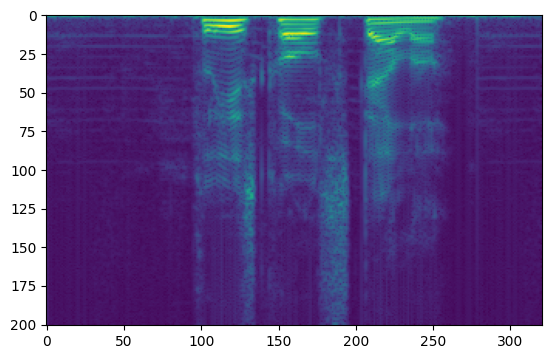

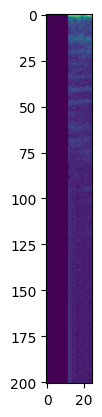

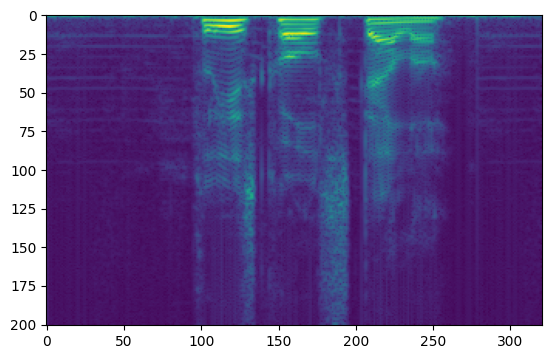

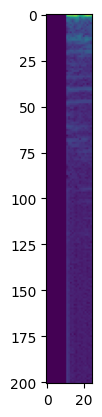

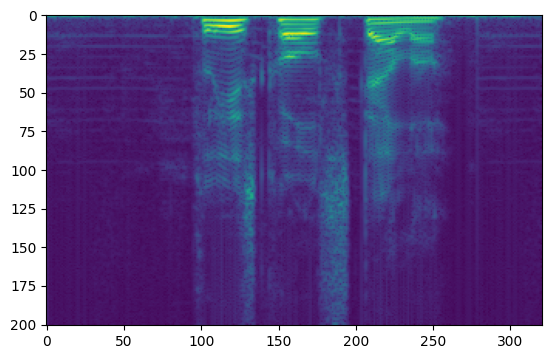

...

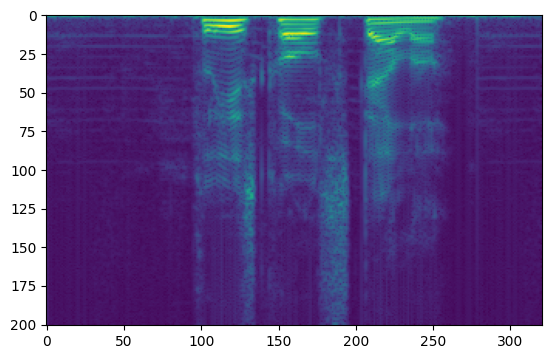

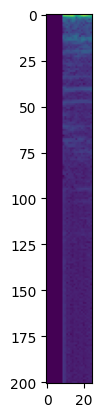

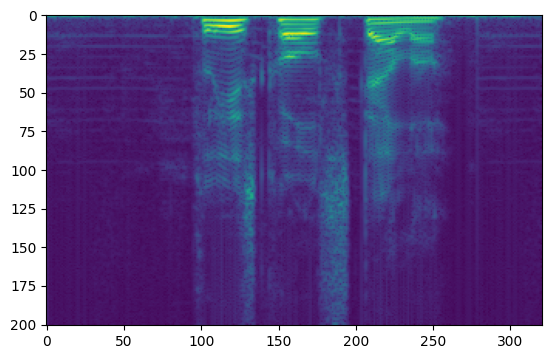

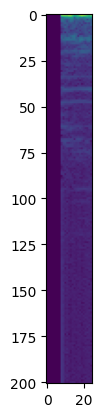

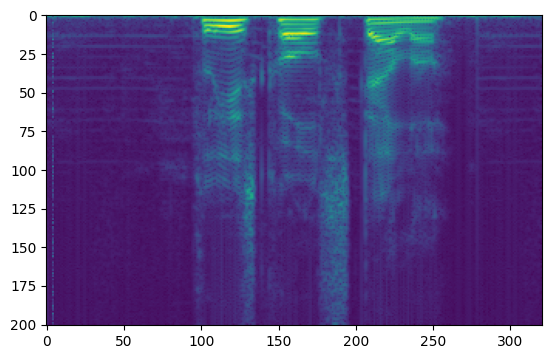

In [87]:
trainer = DDPGTrainer(train_ds, test_ds, 25, 0.0005, None)
env = SpeechEnhancementAgent(window = (25 // 2), 
                             buffer_size=1000,
                             n_fft=400,
                             hop=100,
                             gpu_id=None)

ACCUM_STEP=25
for i, batch in enumerate(train_ds):
    #Preprocess batch
    batch = trainer.preprocess_batch(batch)
    #Run episode
    env.set_batch(batch)
    
    for step in range(env.steps-1):  
        #get the window input
        inp = env.get_state_input(env.state, step)

        #print("inp:",inp.shape)

        #plt.imshow(env.state['clean_mag'][0, 0, ...])
        #plt.figure()
        plt.imshow(env.state['est_mag'][0, 0, ...])
        plt.figure()
        inp_mag = torch.sqrt(inp[:, 0, :, :]**2 + inp[:, 1, :, :]**2)
        plt.imshow(inp_mag[0].T)

        #Forward pass through actor to get the action(mask)
        action = trainer.actor(inp)
        print("action:", action[0].shape, action[1].shape)
        #Add noise to the action
        #action = env.noise.get_action(action)

        #Apply mask to get the next state
        next_state = env.get_next_state(state=env.state, 
                                        action=action, 
                                        t=step)
        plt.figure()
        plt.imshow(next_state['est_mag'][0, 0, ...])
        print("-"*50)
        if next_state is None:
            continue

        #Calculate the reward
        reward = env.get_reward(env.state, next_state, 0)
        
        print(reward)
        if (step+1) % 5 == 0:
            break
        """
        env.exp_buffer.push(state={k:v.detach().cpu().numpy() for k, v in env.state.items()}, 
                                    action=(action[0].detach().cpu().numpy(), action[1].detach().cpu()), 
                                    reward=reward.detach().cpu().numpy(), 
                                    next_state={k:v.detach().cpu().numpy() for k, v in next_state.items()},
                                    t=step)
                
                
        #sample experience from buffer
        experience = env.exp_buffer.sample()

        next_t = experience['t'] + 1
        next_inp = env.get_state_input(experience['next'], next_t)
        next_action = self.target_actor(next_inp)
        
        #Set TD target
        value_curr = self.critic(experience['curr'], experience['action'], experience['t'])
        value_next = self.target_critic(experience['next'], next_action, next_t)
        y_t = experience['reward'] + args.gamma * value_next

        #critic loss
        critic_loss = F.mse_loss(y_t, value_curr)
        critic_loss = critic_loss.mean()
        
        #actor loss
        a_inp = env.get_state_input(experience['curr'], experience['t'])
        a_action = self.actor(a_inp)
        actor_loss = -self.critic(experience['curr'], a_action, experience['t']).mean()

        #Update networks
        actor_loss = actor_loss / ACCUM_STEP
        critic_loss = critic_loss / ACCUM_STEP
        critic_loss.backward()
        actor_loss.backward()

        if (step+1) % ACCUM_STEP == 0 or (step == env.steps - 2):
            self.a_optimizer.step()
            self.a_optimizer.zero_grad()

            self.c_optimizer.step()
            self.c_optimizer.zero_grad()
            
            #update target networks
            for target_param, param in zip(self.target_actor.parameters(), self.actor.parameters()):
                target_param.data.copy_(param.data * args.tau + target_param.data * (1.0 - args.tau))
        
            for target_param, param in zip(self.target_critic.parameters(), self.critic.parameters()):
                target_param.data.copy_(param.data * args.tau + target_param.data * (1.0 - args.tau))
        
        #update state
        env.state = next_state
        """
    break
    

Step:0
Step:1
Step:2
Step:3
Step:4
Step:5
Step:6
Step:7
Step:8
Step:9
Step:10
Step:11
Step:12
Step:13
Step:14
Step:15
Step:16
Step:17
Step:18
Step:19
Step:20
Step:21
Step:22
Step:23
Step:24
Step:25
Step:26
Step:27
Step:28
Step:29
Step:30
Step:31
Step:32
Step:33
Step:34
Step:35
Step:36


/var/folders/h6/6w1fv4ks2hq54txlt9l2ygy00000gn/T/ipykernel_6073/3494863603.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Step:37
Step:38
Step:39
Step:40
Step:41
Step:42
Step:43
Step:44
Step:45
Step:46
Step:47
Step:48
Step:49
Step:50
Step:51
Step:52
Step:53
Step:54
Step:55
Step:56
Step:57
Step:58
Step:59
Step:60
Step:61
Step:62
Step:63
Step:64
Step:65
Step:66
Step:67
Step:68
Step:69
Step:70
Step:71
Step:72
Step:73
Step:74
Step:75
Step:76
Step:77
Step:78
Step:79
Step:80
Step:81
Step:82
Step:83
Step:84
Step:85
Step:86
Step:87
Step:88
Step:89
Step:90
Step:91
Step:92
Step:93
Step:94
Step:95
Step:96
Step:97
Step:98
Step:99
Step:100
Step:101
Step:102
Step:103
Step:104
Step:105
Step:106
Step:107
Step:108
Step:109
Step:110
Step:111
Step:112
Step:113
Step:114
Step:115
Step:116
Step:117
Step:118
Step:119
Step:120
Step:121
Step:122
Step:123
Step:124
Step:125
Step:126
Step:127
Step:128
Step:129
Step:130
Step:131
Step:132
Step:133
Step:134
Step:135
Step:136
Step:137
Step:138
Step:139
Step:140
Step:141
Step:142
Step:143
Step:144
Step:145
Step:146
Step:147
Step:148
Step:149
Step:150
Step:151
Step:152
Step:153
Step:154
S

FileNotFoundError: [Errno 2] No such file or directory: '/Users/anuragkumar/Anurag/SpeechEnhancement_RLHF/specs//step_320_est_spec.pt'

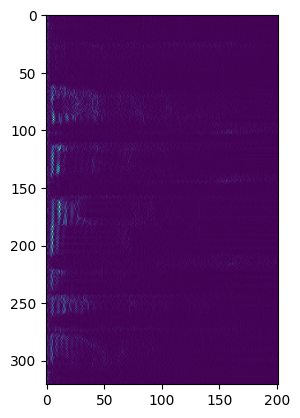

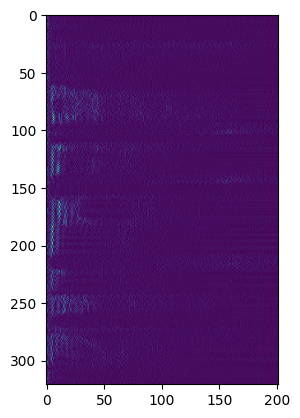

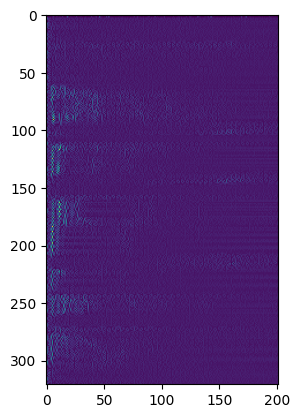

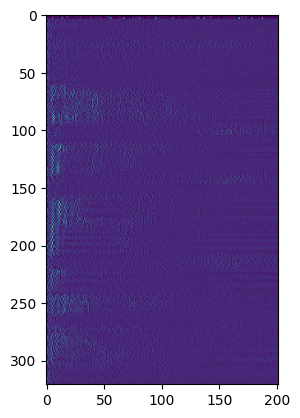

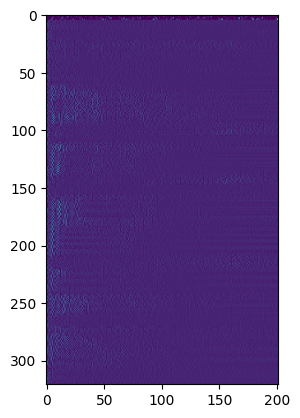

...

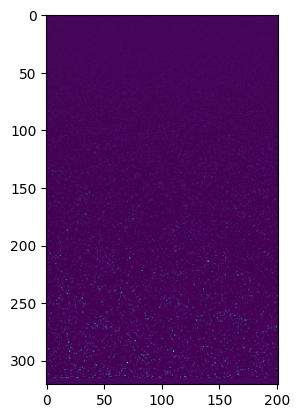

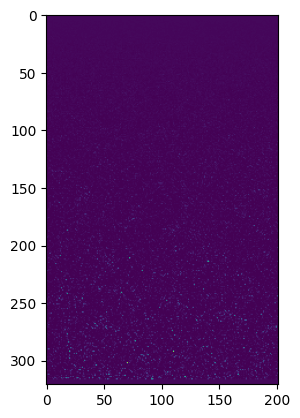

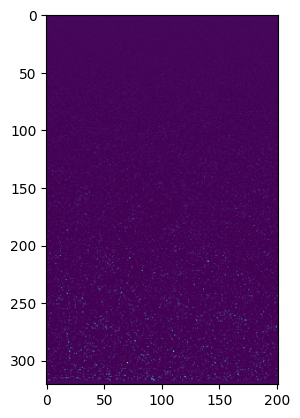

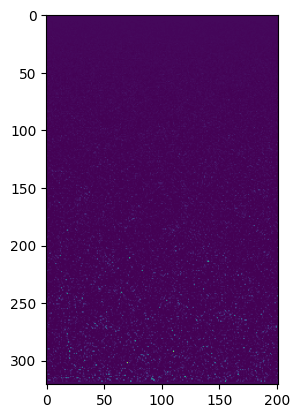

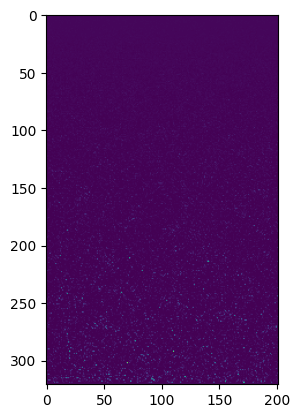

<Figure size 640x480 with 0 Axes>

In [15]:
path = "/Users/anuragkumar/Anurag/SpeechEnhancement_RLHF/specs/"

for step in range(321):
    f = f"step_{step}_est_spec.pt"
    stft = torch.load(f"{path}/{f}")
    stft = stft.detach().cpu().numpy()
    mag = np.sqrt(stft[0, :, :, 0]**2 + stft[0, :, :, 1]**2)
    print(f"Step:{step}")
    plt.imshow(mag.T)
    plt.figure()
    

In [133]:
src = TSCNet2(num_channel=16, num_features=201)
tar = TSCNet(num_channel=16, num_features=201, win_len=25, gpu_id=None)
torch.load("/Users/anuragkumar/Anurag/CMGAN/src/best_ckpt/ckpt", src)

TypeError: forward() takes 2 positional arguments but 3 were given

In [121]:
i=0
for target_param, param in zip(src.parameters(), tar.parameters()):
    #print(target_param, param)
    try:
        print(i)
        target_param.data.copy_(param.data)
        i+=1
    except:
        continue

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
27

In [126]:
src_layers = dict(src.named_parameters())
tar_layers = dict(tar.named_parameters())

L: dense_encoder.conv_1.0.weight dense_encoder.conv_1.0.weight
Parameter containing:
tensor([[[[ 0.2078]],

         [[-0.4794]],

         [[-0.3262]]],


        [[[ 0.1241]],

         [[-0.2704]],

         [[ 0.4284]]],


        [[[ 0.3081]],

         [[ 0.2864]],

         [[-0.0136]]],


        [[[ 0.2961]],

         [[-0.4675]],

         [[ 0.2775]]],


        [[[ 0.5545]],

         [[ 0.2389]],

         [[-0.5475]]],


        [[[-0.1038]],

         [[-0.0326]],

         [[-0.2809]]],


        [[[-0.2795]],

         [[ 0.2361]],

         [[-0.4741]]],


        [[[ 0.1651]],

         [[ 0.0043]],

         [[ 0.3520]]],


        [[[-0.2284]],

         [[ 0.4000]],

         [[-0.4376]]],


        [[[ 0.3614]],

         [[-0.0525]],

         [[ 0.5461]]],


        [[[-0.2473]],

         [[-0.1079]],

         [[-0.5598]]],


        [[[-0.4073]],

         [[-0.4299]],

         [[ 0.2053]]],


        [[[ 0.2907]],

         [[ 0.1677]],

         [[ 0.390

In [119]:
for layer in named_layers:
    print(layer)

len(named_layers)


dense_encoder
dense_encoder.conv_1
dense_encoder.conv_1.0
dense_encoder.conv_1.1
dense_encoder.conv_1.2
dense_encoder.dilated_dense
dense_encoder.dilated_dense.pad
dense_encoder.dilated_dense.pad1
dense_encoder.dilated_dense.conv1
dense_encoder.dilated_dense.norm1
dense_encoder.dilated_dense.prelu1
dense_encoder.dilated_dense.pad2
dense_encoder.dilated_dense.conv2
dense_encoder.dilated_dense.norm2
dense_encoder.dilated_dense.prelu2
dense_encoder.dilated_dense.pad3
dense_encoder.dilated_dense.conv3
dense_encoder.dilated_dense.norm3
dense_encoder.dilated_dense.prelu3
dense_encoder.dilated_dense.pad4
dense_encoder.dilated_dense.conv4
dense_encoder.dilated_dense.norm4
dense_encoder.dilated_dense.prelu4
dense_encoder.conv_2
dense_encoder.conv_2.0
dense_encoder.conv_2.1
dense_encoder.conv_2.2
TSCB_1
TSCB_1.time_conformer
TSCB_1.time_conformer.ff1
TSCB_1.time_conformer.ff1.fn
TSCB_1.time_conformer.ff1.fn.fn
TSCB_1.time_conformer.ff1.fn.fn.net
TSCB_1.time_conformer.ff1.fn.fn.net.0
TSCB_1.time

434